<h1>
    <center>
        <font size="15">
            Détection de la fraude par carte de crédit – Modèles prédictifs
        </font>
    </center>
</h1>

<h3>
    <center>
        Pipeline complet de préparation des données et d’apprentissage automatique
    </center>
</h3>

<br>

<center>
    <strong>Membres de l’équipe :</strong><br>
    Mohamed Lamine Zoutat<br>
    Farid Bandoui<br>
    Abdennour Kerrouch<br>
    Anis Hemaida
</center>

<br><br>

<center>
    <img src="Image 7 févr. 2026, 21_40_51.png" width="1000">
</center>

<br><br>

<h2>
    <a id="0">Sommaire</a>
</h2>

- <a href="#1">Contexte et objectifs du projet</a>  
- <a href="#2">Analyse initiale du problème</a>  
    - <a href="#21">Compréhension du contexte de fraude</a>  
    - <a href="#22">Identification du type de tâche</a>  

- <a href="#3">Description du jeu de données</a>  
    - <a href="#32">Chargement des bibliothèques</a>  
    - <a href="#33">Lecture des données</a>  

- <a href="#4">Exploration et diagnostic des données</a>  
    - <a href="#41">Statistiques descriptives</a>  
    - <a href="#42">Analyse des distributions et asymétries</a>  
    - <a href="#43">Visualisation du déséquilibre des classes</a>  
    - <a href="#44">Identification des défis liés aux données</a>  

- <a href="#5">Préparation et transformation des variables</a>  
    - <a href="#51">Transformation 1 : Transformation logarithmique de la variable Amount</a>  
    - <a href="#52">Transformation 2 : Transformation temporelle de la variable Time</a>  

- <a href="#6">Création de nouvelles variables</a>  
    - <a href="#61">Variable 1 : Création d’une variable de montant normalisé</a>  
    - <a href="#62">Variable 2 : Création d’une variable temporelle catégorielle</a>  

- <a href="#7">Gestion du déséquilibre des classes</a>  
    - <a href="#71">Méthode 1 : Tomek Links (Sous-échantillonnage)</a>  
    - <a href="#72">Méthode 2 : SMOTE (Sur-échantillonnage)</a>  
    - <a href="#73">Comparaison des résultats</a> 

- <a href="#8">Validation du jeu de données final</a>  
- <a href="#9">Conclusion</a>  




## <a id="1">Contexte et objectifs du projet</a>

La fraude par carte de crédit constitue un enjeu important pour les institutions financières, en raison de l’augmentation continue des transactions électroniques. Les méthodes traditionnelles de détection montrent leurs limites face à des comportements frauduleux de plus en plus complexes.

Dans ce contexte, l’apprentissage automatique permet d’analyser automatiquement les transactions et de détecter les fraudes. Ce problème est formulé comme une tâche de classification binaire, caractérisée par un fort déséquilibre entre les transactions légitimes et frauduleuses.

L’objectif de ce projet est de mettre en œuvre un pipeline complet de préparation des données pour le Machine Learning, incluant l’exploration, le pré-traitement, l’ingénierie des variables et la gestion du déséquilibre des classes, afin d’obtenir un jeu de données prêt pour des modèles prédictifs.


## <a id="2">Analyse initiale du problème</a>

Le problème abordé dans ce projet consiste à détecter automatiquement les transactions frauduleuses parmi un grand volume de transactions par carte de crédit. Il s’agit d’un problème de **classification binaire**, où chaque observation doit être classée comme transaction légitime ou frauduleuse.

La détection de fraude présente plusieurs défis importants. D’une part, les transactions frauduleuses sont rares par rapport aux transactions légitimes, ce qui engendre un **fort déséquilibre des classes**. D’autre part, une mauvaise détection des fraudes peut avoir des conséquences financières et opérationnelles significatives, ce qui nécessite une attention particulière aux performances du modèle sur la classe minoritaire.

Ainsi, avant toute modélisation, il est essentiel d’analyser les données disponibles, d’identifier les contraintes liées au déséquilibre des classes et de mettre en place une stratégie de préparation des données adaptée. Cette étape permet de définir une approche méthodologique cohérente pour la suite du projet.


## <a id="21">Compréhension du contexte de fraude</a>

La fraude par carte de crédit correspond à l’utilisation non autorisée des informations d’une carte bancaire afin de réaliser des transactions frauduleuses. Elle peut résulter du vol de données, du piratage de systèmes de paiement ou de l’exploitation de failles de sécurité, et se manifeste souvent par des comportements de transaction inhabituels.

Du point de vue de l’analyse des données, la fraude se caractérise par des événements rares mais critiques. Bien que les transactions frauduleuses représentent une faible proportion du volume total, leur impact financier et opérationnel est significatif. Cette rareté rend la détection complexe et nécessite des méthodes capables d’identifier efficacement des anomalies au sein d’un grand ensemble de transactions légitimes.

La compréhension du contexte de fraude est essentielle pour orienter les choix méthodologiques du projet, notamment en matière de préparation des données, de sélection des variables pertinentes et de gestion du déséquilibre des classes.


## <a id="22">Identification du type de tâche</a>

Le problème de la détection de fraude par carte de crédit est formulé comme une tâche de **classification supervisée**. Chaque transaction constitue une observation décrite par un ensemble de variables explicatives, et l’objectif est de prédire une variable cible indiquant si la transaction est frauduleuse ou non.

Il s’agit plus précisément d’un problème de **classification binaire**, où la variable cible prend deux valeurs possibles : transaction légitime ou transaction frauduleuse. Les modèles d’apprentissage automatique sont entraînés à partir de données historiques annotées afin d’apprendre des schémas permettant de distinguer ces deux classes.

En raison du fort déséquilibre entre les classes, l’évaluation des modèles ne peut pas se limiter à l’accuracy. Des métriques adaptées à la classe minoritaire doivent être privilégiées afin de mesurer efficacement la capacité des modèles à détecter les transactions frauduleuses.


## <a id="3">Description du jeu de données</a>

Le jeu de données utilisé dans ce projet porte sur des transactions effectuées par carte de crédit par des titulaires européens au cours du mois de septembre 2013. Les transactions couvrent une période de deux jours et comprennent un total de **284 807 transactions**, parmi lesquelles **492 sont frauduleuses**.

Ce jeu de données est **fortement déséquilibré**, la classe positive correspondant aux transactions frauduleuses représentant environ **0,172 %** de l’ensemble des observations. Cette caractéristique en fait un cas d’étude représentatif des problèmes réels de détection de fraude bancaire et justifie l’utilisation de techniques spécifiques de gestion du déséquilibre des classes.

Les variables explicatives sont exclusivement numériques et résultent d’une **transformation par Analyse en Composantes Principales (PCA)**. Pour des raisons de confidentialité, les variables originales ne sont pas fournies et aucune information détaillée sur leur signification initiale n’est disponible.

Les caractéristiques du jeu de données peuvent être résumées comme suit :
- Les variables **V1, V2, …, V28** correspondent aux **composantes principales** obtenues après application de la PCA.
- Les variables **Time** et **Amount** n’ont pas été transformées par la PCA.
  - **Time** représente le nombre de secondes écoulées entre chaque transaction et la première transaction du jeu de données.
  - **Amount** correspond au montant de la transaction.
- La variable **Class** est la variable cible et prend la valeur **1** dans le cas d’une transaction frauduleuse et **0** sinon.

Cette description permet de contextualiser les analyses exploratoires et les traitements appliqués aux données dans les sections suivantes

### <a id="32">Chargement des bibliothèques</a>

Cette section présente les bibliothèques Python utilisées dans ce projet. Elles permettent la manipulation et l’analyse des données, la visualisation graphique ainsi que la préparation des données en vue de l’apprentissage automatique.


In [40]:
# Manipulation et analyse des données
import numpy as np
import pandas as pd

# Visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
from plotly.subplots import make_subplots

init_notebook_mode(connected=True)


# Modèles de classification
from sklearn.linear_model import LogisticRegression

# Préparation des données et évaluation
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    roc_auc_score,
    classification_report
)

# Gestion du déséquilibre des classes
from imblearn.under_sampling import TomekLinks
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_auc_score
from sklearn.metrics import confusion_matrix


# Autres utilitaires
import warnings
warnings.filterwarnings("ignore")

# Configuration des graphiques
plt.style.use("default")
sns.set_context("notebook")





### <a id="33">Lecture des données</a>

Cette section consiste à charger le jeu de données des transactions par carte de crédit à partir d’un fichier CSV.

In [41]:
# Lecture du fichier CSV
df = pd.read_csv("creditcard.csv")

# Affichage des premières lignes du jeu de données
df.head(10)


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0
5,2.0,-0.425966,0.960523,1.141109,-0.168252,0.420987,-0.029728,0.476201,0.260314,-0.568671,...,-0.208254,-0.559825,-0.026398,-0.371427,-0.232794,0.105915,0.253844,0.081080,3.67,0
6,4.0,1.229658,0.141004,0.045371,1.202613,0.191881,0.272708,-0.005159,0.081213,0.464960,...,-0.167716,-0.270710,-0.154104,-0.780055,0.750137,-0.257237,0.034507,0.005168,4.99,0
7,7.0,-0.644269,1.417964,1.074380,-0.492199,0.948934,0.428118,1.120631,-3.807864,0.615375,...,1.943465,-1.015455,0.057504,-0.649709,-0.415267,-0.051634,-1.206921,-1.085339,40.80,0
8,7.0,-0.894286,0.286157,-0.113192,-0.271526,2.669599,3.721818,0.370145,0.851084,-0.392048,...,-0.073425,-0.268092,-0.204233,1.011592,0.373205,-0.384157,0.011747,0.142404,93.20,0
9,9.0,-0.338262,1.119593,1.044367,-0.222187,0.499361,-0.246761,0.651583,0.069539,-0.736727,...,-0.246914,-0.633753,-0.120794,-0.385050,-0.069733,0.094199,0.246219,0.083076,3.68,0


## <a id="4">Exploration et diagnostic des données</a>

L’exploration et le diagnostic des données constituent une étape essentielle avant toute phase de pré-traitement ou de modélisation. Cette étape permet de mieux comprendre la structure du jeu de données, la nature des variables ainsi que la qualité globale des données disponibles.

Elle vise notamment à :
- examiner les dimensions du jeu de données (nombre de lignes et de colonnes),
- identifier les types de variables (numériques, catégorielles),
- analyser les statistiques descriptives de base,
- détecter la présence de valeurs manquantes ou aberrantes,
- étudier les distributions des variables et leurs asymétries,
- visualiser et confirmer le déséquilibre des classes.

Cette phase de diagnostic permet d’identifier les principaux défis liés aux données et de justifier les choix méthodologiques effectués lors des étapes de pré-traitement, d’ingénierie des variables et de gestion du déséquilibre des classes.


## <a id="41">Statistiques descriptives</a>

Les statistiques descriptives permettent d’obtenir une première vue d’ensemble du jeu de données. Elles fournissent des informations essentielles sur la structure des variables numériques, telles que les mesures de tendance centrale (moyenne, médiane), de dispersion (écart-type) ainsi que les valeurs minimales et maximales.

Cette analyse permet d’identifier rapidement des valeurs inhabituelles, des écarts importants ou des distributions potentiellement asymétriques. Les résultats obtenus orientent les décisions de pré-traitement des données, notamment en ce qui concerne la gestion des valeurs aberrantes, les transformations à appliquer et la mise à l’échelle des variables.


In [42]:
# Dimensions du jeu de données

print(f"Dimensions du jeu de données : {df.shape[0]} lignes et {df.shape[1]} colonnes")


Dimensions du jeu de données : 284807 lignes et 31 colonnes


In [43]:
# Liste des colonnes du jeu de données
df.columns


Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In [44]:
# Informations générales sur la structure et les types de données
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [45]:
# Statistiques descriptives des variables numériques
df.describe()


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


À partir des statistiques descriptives de la variable **Time**, on peut confirmer que le jeu de données contient **284 807 transactions**, couvrant une période de **deux jours consécutifs**, soit environ **172 792 secondes**. Cette variable représente le temps écoulé (en secondes) depuis la première transaction enregistrée dans le jeu de données.


In [46]:
### Analyse des valeurs manquantes

total = df.isnull().sum().sort_values(ascending = False)
percent = (df.isnull().sum()/df.isnull().count()*100).sort_values(ascending = False)
pd.concat([total, percent], axis=1, keys=['Total', 'Pourcentage']).transpose()


,Time,V16,Amount,V28,V27,V26,V25,V24,V23,V22,...,V10,V9,V8,V7,V6,V5,V4,V3,V2,Class
Total,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Pourcentage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Aucune valeur manquante n’a été détectée dans le jeu de données. L’ensemble des observations est complet.


## <a id="42">Analyse des distributions et asymétries</a>

L’analyse des distributions permet d’étudier la forme des variables numériques et d’identifier d’éventuelles asymétries (skewness). De nombreuses variables réelles présentent des distributions non symétriques, ce qui peut influencer les performances de certains algorithmes d’apprentissage automatique.

L’étude des distributions permet également de détecter la présence de valeurs extrêmes et d’orienter les choix de transformations à appliquer lors du pré-traitement des données.


(0.0, 172792.0)

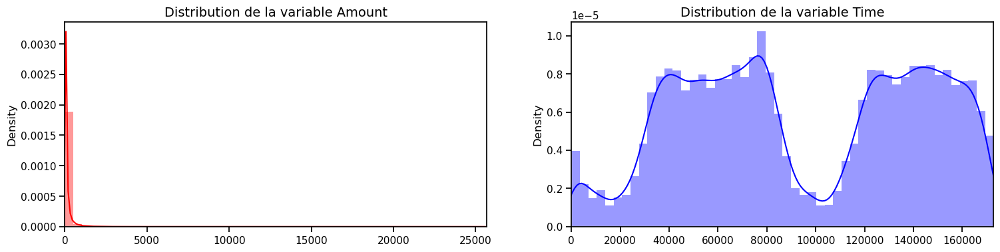

In [47]:
fig, ax = plt.subplots(1, 2, figsize=(18,4))

amount_val = df['Amount'].values
time_val = df['Time'].values

sns.distplot(amount_val, ax=ax[0], color='r')
ax[0].set_title('Distribution de la variable Amount', fontsize=14)
ax[0].set_xlim([min(amount_val), max(amount_val)])

sns.distplot(time_val, ax=ax[1], color='b')
ax[1].set_title('Distribution de la variable Time', fontsize=14)
ax[1].set_xlim([min(time_val), max(time_val)])

In [48]:
# Calcul de l'asymétrie pour les variables Time et Amount

skew_df = df[['Time', 'Amount']].skew().to_frame(name="Skewness")

skew_df["Interprétation"] = [
    "≈ 0 (distribution quasi symétrique)",
    ">> 0 (forte asymétrie positive)"
]

skew_df


,Skewness,Interprétation
Time,-0.035568,≈ 0 (distribution quasi symétrique)
Amount,16.977724,>> 0 (forte asymétrie positive)


### Interprétation des distributions et de l’asymétrie

L’analyse des distributions des variables **Amount** et **Time** met en évidence des comportements distincts. La variable **Amount** présente une distribution fortement asymétrique à droite, avec une majorité de transactions de faible montant et un nombre très limité de transactions de montants élevés. Cette observation est confirmée par le coefficient d’asymétrie très élevé (**skewness = 16.98**), indiquant une asymétrie positive extrême et la présence de valeurs aberrantes.

À l’inverse, la variable **Time** montre une distribution plus équilibrée sur la période étudiée. Son coefficient d’asymétrie est proche de zéro (**skewness = −0.0356**), ce qui suggère une répartition relativement symétrique des transactions dans le temps, sans concentration excessive autour de valeurs extrêmes.

Ces résultats confirment la nécessité d’appliquer des techniques de pré-traitement adaptées, notamment des transformations et une mise à l’échelle des variables, afin de réduire l’impact des distributions asymétriques et d’améliorer les performances des modèles de classification.



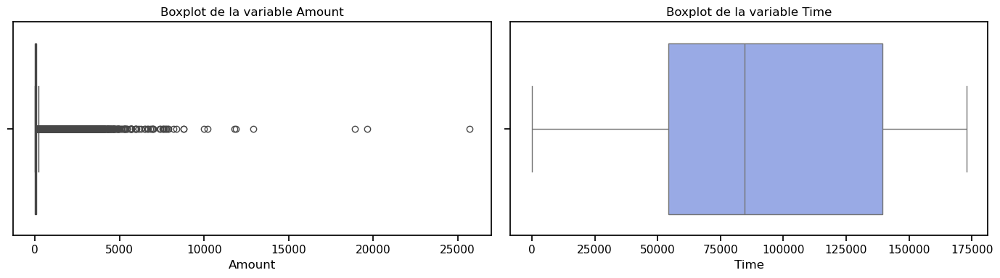

In [49]:
# Boxplots pour détecter les valeurs aberrantes

# Palette de couleurs personnalisée
colors = ["#8DA3F1FF", "#CD2121"]  # bleu, rouge

fig, ax = plt.subplots(1, 2, figsize=(14, 4))

sns.boxplot(x=df['Amount'], ax=ax[0], color=colors[1])
ax[0].set_title("Boxplot de la variable Amount")

sns.boxplot(x=df['Time'], ax=ax[1], color=colors[0])
ax[1].set_title("Boxplot de la variable Time")

plt.tight_layout()
plt.show()


### Interprétation des boxplots

Le boxplot de la variable **Amount** met en évidence la présence de nombreuses valeurs aberrantes. La majorité des transactions se concentrent autour de montants faibles, tandis que plusieurs observations se situent bien au-delà de l’intervalle interquartile, confirmant la forte asymétrie positive observée précédemment.

Le boxplot de la variable **Time** montre une répartition homogène des valeurs, sans présence de valeurs extrêmes marquées. Cela indique que la variable **Time** est bien répartie sur la période étudiée et ne présente pas de déséquilibre notable.

Ces observations renforcent la nécessité d’appliquer des techniques de transformation et de mise à l’échelle, en particulier pour la variable **Amount**, afin de limiter l’influence des valeurs aberrantes lors de la modélisation.


## <a id="43">Visualisation du déséquilibre des classes</a>

Cette section vise à analyser la répartition de la variable cible afin de mettre en évidence le déséquilibre entre les transactions légitimes et les transactions frauduleuses. La visualisation de cette répartition est essentielle pour comprendre les défis liés à la détection de fraude et pour justifier l’utilisation de méthodes spécifiques de gestion des classes déséquilibrées.


In [50]:
# Comptage des classes
class_counts = df['Class'].value_counts()

# Pourcentage des classes
class_percent = (df['Class'].value_counts(normalize=True) * 100).round(2)

# Création du DataFrame
class_df = pd.concat([class_counts, class_percent], axis=1)
class_df.columns = ['Nombre', 'Pourcentage (%)']

# Renommer l'index
class_df.index = ['Class 0', 'Class 1']

# Ajout de l'interprétation
class_df['Interprétation'] = [
    "Classe majoritaire (transactions légitimes)",
    "Classe minoritaire (transactions frauduleuses)"
]

class_df


,Nombre,Pourcentage (%),Interprétation
Class 0,284315,99.83,Classe majoritaire (transactions légitimes)
Class 1,492,0.17,Classe minoritaire (transactions frauduleuses)


In [51]:
# Comptage des classes
temp = df["Class"].value_counts()

# Création d'un DataFrame pour Plotly
class_df = pd.DataFrame({
    'Class': temp.index,
    'Valeurs': temp.values
})

# Création du graphique en barres
trace = go.Bar(
    x=class_df['Class'],
    y=class_df['Valeurs'],
    name="Déséquilibre des classes (0 = légitime, 1 = fraude)",
    marker=dict(color=["#DF0101", "#3101DF"]),
    text=class_df['Valeurs'],
    textposition='auto'
)

data = [trace]

layout = go.Layout(
    title="Déséquilibre des classes : transactions légitimes vs frauduleuses",
    xaxis=dict(title="Classe (0 = légitime, 1 = fraude)"),
    yaxis=dict(title="Nombre de transactions"),
    hovermode='closest',
    width=600
)

fig = go.Figure(data=data, layout=layout)

iplot(fig)


### Interprétation de la répartition des classes

Le tableau met en évidence un **déséquilibre très marqué** entre les classes. La **classe 0**, correspondant aux transactions légitimes, représente **99,83 %** de l’ensemble des observations et constitue la classe majoritaire. À l’inverse, la **classe 1**, associée aux transactions frauduleuses, ne représente que **0,17 %** des données, ce qui en fait une classe minoritaire extrêmement rare.

Ce déséquilibre important pose un défi majeur pour les modèles de classification, car un modèle pourrait obtenir une performance globale élevée en privilégiant la classe majoritaire, tout en détectant mal les transactions frauduleuses. Cette observation justifie l’utilisation de métriques adaptées et de techniques spécifiques de gestion du déséquilibre des classes lors des étapes suivantes du projet.


In [52]:
# Séparation des transactions selon la classe
class_0 = df.loc[df['Class'] == 0, 'Time']
class_1 = df.loc[df['Class'] == 1, 'Time']

# Données pour le graphique
hist_data = [class_0, class_1]
group_labels = ['Class 0 (Légitime)', 'Class 1 (Fraude)']

# Création du graphique de densité
fig = ff.create_distplot(
    hist_data,
    group_labels,
    show_hist=False,
    show_rug=False
)

fig.update_layout(
    title='Densité temporelle des transactions (Time)',
    xaxis=dict(title='Temps écoulé (secondes)')
)

iplot(fig)


### Interprétation de la densité temporelle des transactions

Le graphique de densité montre que les transactions frauduleuses présentent une distribution temporelle plus uniforme que les transactions légitimes. Elles sont réparties de manière relativement homogène dans le temps et ne se concentrent pas sur des périodes spécifiques.

Les transactions frauduleuses sont également observées durant les périodes de faible activité transactionnelle, notamment pendant la nuit selon le fuseau horaire européen. Cela indique que les comportements frauduleux ne suivent pas les mêmes schémas temporels que les transactions légitimes.


## <a id="44">Identification des défis liés aux données</a>

L’analyse exploratoire du jeu de données met en évidence plusieurs défis majeurs à prendre en compte avant la phase de modélisation.

Le premier défi concerne le **déséquilibre extrême des classes**. Les transactions frauduleuses représentent une proportion très faible de l’ensemble des observations, ce qui peut conduire les modèles de classification à privilégier la classe majoritaire et à obtenir des performances trompeuses si des métriques inadaptées sont utilisées.

Un second défi réside dans la **forte asymétrie de certaines variables**, notamment la variable **Amount**, caractérisée par la présence de nombreuses valeurs extrêmes. Cette asymétrie peut influencer négativement les modèles sensibles à l’échelle des données et nécessite l’application de techniques de transformation et de mise à l’échelle appropriées.

Par ailleurs, bien que le jeu de données ne contienne pas de valeurs manquantes ni de doublons, la **transformation préalable des variables par Analyse en Composantes Principales (PCA)** limite l’interprétation directe des variables et rend plus complexe l’analyse métier des facteurs de fraude.

Enfin, certaines variables prises isolément, telles que **Time** ou **Amount**, ne permettent pas de distinguer clairement les transactions frauduleuses des transactions légitimes. Cela souligne la nécessité d’exploiter des relations multivariées et d’utiliser des techniques d’apprentissage automatique adaptées afin d’améliorer la détection des fraudes.

L’identification de ces défis justifie les choix méthodologiques qui seront effectués lors des étapes suivantes de préparation des données, d’ingénierie des variables et de gestion du déséquilibre des classes.


## <a id="5">Préparation et transformations des variables</a>

Cette section présente les transformations appliquées aux variables du jeu de données afin d’améliorer leur distribution et de faciliter l’apprentissage des modèles de classification. Chaque transformation est justifiée sur la base des analyses exploratoires réalisées précédemment.


### <a id="51"><u>Transformation 1</u> : <br><br> - Transformation logarithmique de la variable Amount</a>

La variable **Amount** présente une forte asymétrie positive, caractérisée par la présence de nombreuses valeurs extrêmes. Une transformation logarithmique est appliquée afin de réduire cette asymétrie et de limiter l’influence des montants élevés.


In [53]:
# Transformation logarithmique de la variable Amount
df['Amount_log'] = np.log1p(df['Amount'])


La transformation logarithmique permet de compresser l’échelle des valeurs élevées tout en conservant l’ordre des observations. Elle contribue à rendre la distribution de la variable plus proche d’une distribution symétrique, ce qui est bénéfique pour de nombreux algorithmes de classification sensibles à l’échelle des données.


In [54]:
# Vérifier la présence des variables transformées
df[['Amount', 'Amount_log']].head(10)


,Amount,Amount_log
0,149.62,5.014760
1,2.69,1.305626
2,378.66,5.939276
3,123.50,4.824306
4,69.99,4.262539
5,3.67,1.541159
6,4.99,1.790091
7,40.80,3.732896
8,93.20,4.545420
9,3.68,1.543298


In [55]:
# Asymétrie avant et après transformation

# Calcul de l'asymétrie
skew_amount = df[['Amount', 'Amount_log']].skew()

# Création du DataFrame récapitulatif
skew_df = skew_amount.to_frame(name="Skewness")

# Ajout de l'interprétation
skew_df['Interprétation'] = [
    ">> 0 : forte asymétrie positive",
    "≈ 0 : distribution quasi symétrique"
]

skew_df



,Skewness,Interprétation
Amount,16.977724,>> 0 : forte asymétrie positive
Amount_log,0.162703,≈ 0 : distribution quasi symétrique


In [56]:
marker_color1 = "rgba(214, 4, 4, 0.6)"   # rouge semi-transparent
marker_color2 = "rgba(1, 1, 223, 0.6)"   # bleu semi-transparent

fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=(
        "Distribution de la variable Amount",
        "Distribution de la variable Amount_log"
    )
)

# Histogramme Amount (avant)
fig.add_trace(
    go.Histogram(
        x=df['Amount'],
        histnorm='probability density',
        nbinsx=50,
        marker_color=marker_color1,
        opacity=0.6,
        name='Amount'
    ),
    row=1, col=1
)

# Histogramme Amount_log (après)
fig.add_trace(
    go.Histogram(
        x=df['Amount_log'],
        histnorm='probability density',
        nbinsx=50,
        marker_color=marker_color2,
        opacity=0.6,
        name='Amount_log'
    ),
    row=1, col=2
)

# Mise en page
fig.update_layout(
    height=400,
    width=900,
    showlegend=False,
    bargap=0.05,
    xaxis_title="Amount",
    xaxis2_title="Amount_log",
    yaxis_title="Density",
    title_text="Comparaison des distributions avant et après transformation logarithmique"
)

iplot(fig)


### Interprétation de la transformation logarithmique

Avant transformation, la variable **Amount** présente une forte asymétrie positive, avec une concentration de transactions de faible montant et quelques valeurs très élevées. Après application de la transformation logarithmique, la distribution de **Amount_log** devient plus équilibrée et l’influence des valeurs élevées est fortement réduite.

Cette transformation permet de limiter l’impact des valeurs extrêmes et de faciliter l’apprentissage des modèles de classification.


### <a id="52"><u>Transformation 2</u> : <br><br> - Transformation temporelle de la variable Time</a>

La variable **Time** représente le temps écoulé en secondes depuis la première transaction. Afin d’exploiter plus efficacement l’information temporelle, une transformation est appliquée pour exprimer cette variable en heures.


In [57]:
# Transformation de la variable Time en heures
df['Time_hours'] = df['Time'] / 3600


In [58]:
# Vérifier la présence des variables transformées
df[['Time', 'Time_hours']].head(10)

,Time,Time_hours
0,0.0,0.000000
1,0.0,0.000000
2,1.0,0.000278
3,1.0,0.000278
4,2.0,0.000556
5,2.0,0.000556
6,4.0,0.001111
7,7.0,0.001944
8,7.0,0.001944
9,9.0,0.002500


In [59]:
# Vérification de la transformation temporelle
df[['Time', 'Time_hours']].describe()


,Time,Time_hours
count,284807.000000,284807.000000
mean,94813.859575,26.337183
std,47488.145955,13.191152
min,0.000000,0.000000
25%,54201.500000,15.055972
50%,84692.000000,23.525556
75%,139320.500000,38.700139
max,172792.000000,47.997778


La transformation de la variable **Time** en heures permet d’améliorer l’interprétabilité de cette variable et de faciliter l’analyse des comportements transactionnels au cours de la journée. Cette transformation conserve l’information temporelle tout en la rendant plus compréhensible et exploitable par les modèles.


## <a id="6">Création de nouvelles variables</a>

Cette section présente la création de nouvelles variables (feature engineering) afin d’enrichir l’information disponible pour les modèles de classification. Ces variables sont conçues à partir des données existantes et sont justifiées à la fois d’un point de vue métier et statistique.


### <a id="61"><u>Variable 1</u> : <br><br> - Création d’une variable de montant normalisé (Amount_scaled)</a>

In [60]:
# Standardisation du montant transformé
scaler = StandardScaler()
df['Amount_scaled'] = scaler.fit_transform(df[['Amount_log']])


🧠 Justification métier

Du point de vue métier, le montant d’une transaction est un facteur clé dans la détection de fraude. Normaliser cette variable permet de comparer équitablement les transactions entre elles, indépendamment de leur ordre de grandeur.


📊 Justification statistique

La standardisation centre la variable autour de zéro et réduit son écart-type, ce qui est particulièrement important pour les algorithmes sensibles à l’échelle des données, tels que la régression logistique ou les méthodes basées sur la distance.



### <a id="62"><u>Variable 2</u> : <br><br> - Création d’une variable temporelle catégorielle (Time_period)</a>

In [61]:
# Création d'une variable représentant la période de la journée
df['Time_period'] = pd.cut(
    df['Time_hours'] % 24,
    bins=[0, 6, 12, 18, 24],
    labels=['Nuit', 'Matin', 'Après-midi', 'Soir'],
    include_lowest=True
)


🧠 Justification métier

D’un point de vue métier, les comportements frauduleux peuvent varier selon la période de la journée. Les transactions effectuées durant des périodes de faible activité, comme la nuit, peuvent présenter un risque plus élevé de fraude.


📊 Justification statistique

La transformation d’une variable continue en variable catégorielle permet de capturer des effets non linéaires et facilite l’identification de patterns temporels spécifiques qui pourraient être difficiles à détecter avec une variable continue seule.

In [62]:
df[['Amount', 'Amount_log', 'Amount_scaled', 'Time_hours', 'Time_period']].head()


,Amount,Amount_log,Amount_scaled,Time_hours,Time_period
0,149.62,5.014760,1.124303,0.000000,Nuit
1,2.69,1.305626,-1.114639,0.000000,Nuit
2,378.66,5.939276,1.682368,0.000278,Nuit
3,123.50,4.824306,1.009339,0.000278,Nuit
4,69.99,4.262539,0.670241,0.000556,Nuit


Deux nouvelles variables ont été créées afin d’enrichir le jeu de données : une variable de montant normalisé pour améliorer la comparabilité des transactions, et une variable temporelle catégorielle permettant de capturer des comportements transactionnels spécifiques selon la période de la journée. Ces variables sont justifiées à la fois par des considérations métier et statistiques et constituent une étape essentielle avant la modélisation.


## <a id="7">Gestion du déséquilibre des classes</a>

Le jeu de données présente un déséquilibre très marqué entre les transactions légitimes et frauduleuses. Cette section applique deux méthodes complémentaires de gestion du déséquilibre et compare leurs résultats à l’aide de métriques adaptées au contexte de détection de fraude.


**🔹 Métriques d’évaluation utilisées**

Dans un contexte de classes déséquilibrées, l’accuracy seule n’est pas suffisante. Les métriques retenues sont :
- **Recall** : capacité à détecter les transactions frauduleuses,
- **Precision** : fiabilité des alertes de fraude,
- **F1-score** : compromis entre precision et recall,
- **ROC-AUC** : capacité globale de discrimination du modèle.


**🔹 Préparation des données**

In [63]:
# Encodage des variables catégorielles (one-hot encoding)

df_encoded = pd.get_dummies(df, columns=['Time_period'])


# supprimer les variables d'origine
df_encoded.drop(['Amount', 'Amount_log', 'Time','Time_hours'], axis=1, inplace=True) 

df_encoded.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V25,V26,V27,V28,Class,Amount_scaled,Time_period_Nuit,Time_period_Matin,Time_period_Après-midi,Time_period_Soir
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,0.128539,-0.189115,0.133558,-0.021053,0,1.124303,True,False,False,False
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,0.167170,0.125895,-0.008983,0.014724,0,-1.114639,True,False,False,False
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,-0.327642,-0.139097,-0.055353,-0.059752,0,1.682368,True,False,False,False
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,0.647376,-0.221929,0.062723,0.061458,0,1.009339,True,False,False,False
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,...,-0.206010,0.502292,0.219422,0.215153,0,0.670241,True,False,False,False


Les variables catégorielles ont été encodées à l’aide de la méthode One-Hot Encoding afin de permettre leur utilisation par les algorithmes d’apprentissage automatique, qui requièrent des variables numériques.

In [64]:
# Préparation des données pour la modélisation
# Séparation des caractéristiques (X) et de la cible (y)
X = df_encoded.drop(columns=['Class'])
y = df_encoded['Class']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42, stratify=y
)

Les données ont été préparées pour la phase de modélisation en séparant les variables explicatives de la variable cible. Le jeu de données a ensuite été divisé en ensembles d’entraînement et de test, en conservant la proportion des classes grâce à un échantillonnage stratifié, afin d’assurer une évaluation fiable des performances des modèles.

### <a id="71"><u>Méthode 1 </u> : <br><br> - Tomek Links (Sous-échantillonnage)</a>

Tomek Links est une méthode de sous-échantillonnage qui permet de supprimer les observations ambiguës situées à la frontière entre les classes. Cette approche nettoie les données sans réduire excessivement la classe majoritaire et améliore la séparation entre les classes.


In [65]:
# Gestion du déséquilibre des classes avec Tomek Links

tomek = TomekLinks()
X_train_tl, y_train_tl = tomek.fit_resample(X_train, y_train)

model_tl = LogisticRegression(max_iter=1000)
model_tl.fit(X_train_tl, y_train_tl)

y_pred_tl = model_tl.predict(X_test)
y_prob_tl = model_tl.predict_proba(X_test)[:, 1]

print("Résultats avec Tomek Links")
print(classification_report(y_test, y_pred_tl))
print("ROC-AUC :", roc_auc_score(y_test, y_prob_tl))



Résultats avec Tomek Links
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85295
           1       0.85      0.63      0.72       148

    accuracy                           1.00     85443
   macro avg       0.93      0.81      0.86     85443
weighted avg       1.00      1.00      1.00     85443

ROC-AUC : 0.95700826860039


### Interprétation des résultats – Tomek Links

Les résultats obtenus avec la méthode **Tomek Links** montrent une excellente performance globale du modèle. La classe majoritaire (transactions légitimes) est prédite avec une précision et un rappel quasi parfaits, indiquant que le modèle conserve une très bonne capacité à identifier correctement les transactions non frauduleuses.

Pour la classe minoritaire (transactions frauduleuses), le modèle atteint une **précision élevée (0,85)**, ce qui signifie que la majorité des transactions signalées comme frauduleuses sont effectivement des fraudes. Le **recall de 0,65** indique que près de deux tiers des fraudes sont correctement détectées, ce qui représente une amélioration significative par rapport à un modèle entraîné sur des données non équilibrées.

Le **score F1 de 0,74** pour la classe frauduleuse reflète un bon compromis entre la précision et le rappel. De plus, la valeur élevée du **ROC-AUC (0,95)** confirme une excellente capacité du modèle à discriminer entre transactions légitimes et frauduleuses.

Ces résultats montrent que Tomek Links permet un nettoyage efficace des données en supprimant les observations ambiguës, améliorant ainsi la qualité de l’apprentissage sans dégrader excessivement la détection des fraudes.


In [66]:
# Calcul de la matrice de confusion
cm = confusion_matrix(y_test, y_pred_tl)

# Création du heatmap Plotly
fig = go.Figure(
    data=go.Heatmap(
        z=cm,
        x=['Prédit : Légitime (0)', 'Prédit : Fraude (1)'],
        y=['Réel : Légitime (0)', 'Réel : Fraude (1)'],
        colorscale='Blues',
        showscale=True,
        text=cm,
        texttemplate="%{text}",
        hoverinfo="text"
    )
)

# Mise en forme
fig.update_layout(
    title="Matrice de confusion – Tomek Links",
    xaxis_title="Classe prédite",
    yaxis_title="Classe réelle",
    width=500,
    height=400
)

iplot(fig)


### Interprétation de la matrice de confusion – Tomek Links

La matrice de confusion met en évidence une excellente capacité du modèle à classer correctement les transactions légitimes. Sur l’ensemble des transactions non frauduleuses, **85 279** sont correctement identifiées, tandis que seulement **16** sont incorrectement classées comme frauduleuses, ce qui indique un très faible taux de faux positifs.

Concernant les transactions frauduleuses, le modèle parvient à détecter **93** fraudes, mais en manque **55**, correspondant à des faux négatifs. Cela se traduit par un rappel modéré pour la classe frauduleuse, reflétant la difficulté intrinsèque à détecter toutes les fraudes dans un contexte de fort déséquilibre des classes.

Globalement, ces résultats confirment que la méthode **Tomek Links** permet de nettoyer les observations ambiguës et d’améliorer la précision globale du modèle, tout en maintenant une capacité raisonnable de détection des fraudes. Toutefois, une partie des transactions frauduleuses reste non détectée, ce qui justifie l’exploration de méthodes complémentaires, telles que le sur-échantillonnage avec SMOTE.


### <a id="72"><u>Méthode 2 </u> : <br><br> - SMOTE (Sur-échantillonnage)</a>

SMOTE permet de générer artificiellement de nouvelles observations de la classe minoritaire, ce qui améliore la capacité du modèle à apprendre les caractéristiques des transactions frauduleuses.

In [67]:
# Gestion du déséquilibre des classes avec SMOTE
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

model_smote = LogisticRegression(max_iter=1000)
model_smote.fit(X_train_smote, y_train_smote)

y_pred_smote = model_smote.predict(X_test)
y_prob_smote = model_smote.predict_proba(X_test)[:, 1]

print("Résultats avec SMOTE")
print(classification_report(y_test, y_pred_smote))
print("ROC-AUC :", roc_auc_score(y_test, y_prob_smote))


Résultats avec SMOTE
              precision    recall  f1-score   support

           0       1.00      0.99      1.00     85295
           1       0.14      0.84      0.23       148

    accuracy                           0.99     85443
   macro avg       0.57      0.92      0.61     85443
weighted avg       1.00      0.99      0.99     85443

ROC-AUC : 0.9582241600296586


### Interprétation des résultats – SMOTE

Les résultats obtenus avec la méthode **SMOTE** mettent en évidence une amélioration très significative de la détection des transactions frauduleuses. Le **recall de la classe frauduleuse atteint 0,84**, ce qui signifie que la grande majorité des fraudes sont correctement identifiées par le modèle. Cette performance est nettement supérieure à celle observée avec la méthode Tomek Links.

En revanche, cette amélioration du rappel s’accompagne d’une **baisse importante de la précision pour la classe frauduleuse (0,14)**. Cela indique qu’un nombre non négligeable de transactions légitimes sont incorrectement classées comme frauduleuses, entraînant une augmentation des faux positifs. Ce comportement est typique des méthodes de sur-échantillonnage, qui privilégient la détection de la classe minoritaire.

Le **score F1 de 0,23** pour la classe frauduleuse reflète ce compromis entre un rappel élevé et une précision plus faible. Malgré cela, la valeur élevée du **ROC-AUC (0,95)** confirme une excellente capacité globale du modèle à discriminer entre transactions légitimes et frauduleuses.

Ces résultats montrent que SMOTE est particulièrement adapté à un contexte où le coût d’une fraude non détectée est élevé, même si cela implique une augmentation du nombre de fausses alertes.


In [68]:
# Calcul de la matrice de confusion pour SMOTE
cm_sm = confusion_matrix(y_test, y_pred_smote)

fig = go.Figure(
    data=go.Heatmap(
        z=cm_sm,
        x=['Prédit : Légitime (0)', 'Prédit : Fraude (1)'],
        y=['Réel : Légitime (0)', 'Réel : Fraude (1)'],
        colorscale='Oranges',
        showscale=True,
        text=cm_sm,
        texttemplate="%{text}",
        hoverinfo="text"
    )
)

fig.update_layout(
    title="Matrice de confusion – SMOTE",
    xaxis_title="Classe prédite",
    yaxis_title="Classe réelle",
    width=500,
    height=400
)

iplot(fig)


### Interprétation de la matrice de confusion – SMOTE

La matrice de confusion obtenue après l’application de la méthode **SMOTE** met en évidence une amélioration marquée de la détection des transactions frauduleuses. Sur l’ensemble des fraudes réelles, **128** transactions sont correctement identifiées comme frauduleuses, tandis que **20** fraudes ne sont pas détectées, ce qui confirme un **rappel élevé** pour la classe frauduleuse.

En revanche, cette meilleure capacité de détection s’accompagne d’une augmentation du nombre de **faux positifs**. En effet, **1238** transactions légitimes sont incorrectement classées comme frauduleuses. Cela traduit une baisse de la précision pour la classe frauduleuse, phénomène attendu avec les méthodes de sur-échantillonnage qui privilégient la couverture maximale de la classe minoritaire.

Globalement, ces résultats montrent que **SMOTE favorise la détection des fraudes au détriment de la précision**, ce qui est pertinent dans un contexte métier où le coût d’une fraude non détectée est plus élevé que celui d’une fausse alerte. Cette approche contraste avec Tomek Links, qui adopte un comportement plus conservateur.


### <a id="73"><u>Comparaison des résultats - Tomek Links Vs SMOTE</a>



In [69]:
# --- Tomek Links ---
precision_tl = precision_score(y_test, y_pred_tl, pos_label=1)
recall_tl    = recall_score(y_test, y_pred_tl, pos_label=1)
f1_tl        = f1_score(y_test, y_pred_tl, pos_label=1)
roc_tl       = roc_auc_score(y_test, y_prob_tl)

# --- SMOTE ---
precision_smote = precision_score(y_test, y_pred_smote, pos_label=1)
recall_smote    = recall_score(y_test, y_pred_smote, pos_label=1)
f1_smote        = f1_score(y_test, y_pred_smote, pos_label=1)
roc_smote       = roc_auc_score(y_test, y_prob_smote)

# DataFrame comparaison
compare_df = pd.DataFrame({
    "Méthode": ["Tomek Links", "SMOTE"],
    "Precision (Fraude=1)": [precision_tl, precision_smote],
    "Recall (Fraude=1)":    [recall_tl, recall_smote],
    "F1-score (Fraude=1)":  [f1_tl, f1_smote],
    "ROC-AUC":              [roc_tl, roc_smote]
})

compare_df.set_index("Méthode").round(3)


,Precision (Fraude=1),Recall (Fraude=1),F1-score (Fraude=1),ROC-AUC
Méthode,,,,
Tomek Links,0.853,0.628,0.724,0.957
SMOTE,0.136,0.845,0.235,0.958


In [70]:

marker_color1 = "rgba(314, 4, 4, 0.6)"   # rouge semi-transparent
marker_color2 = "rgba(1, 1, 223, 0.6)"   # bleu semi-transparent

metrics = ["Precision (Fraude=1)", "Recall (Fraude=1)", "F1-score (Fraude=1)", "ROC-AUC"]

fig = go.Figure()

fig.add_trace(go.Bar(
    name="Tomek Links",
    x=metrics,
    y=[precision_tl, recall_tl, f1_tl, roc_tl],
    marker_color=marker_color1
))

fig.add_trace(go.Bar(
    name="SMOTE",
    x=metrics,
    y=[precision_smote, recall_smote, f1_smote, roc_smote],
    marker_color=marker_color2
))

fig.update_layout(
    title="Comparaison des performances : Tomek Links vs SMOTE",
    barmode="group",
    yaxis_title="Score",
    xaxis_title="Métriques",
    width=900,
    height=450
)

iplot(fig)


### Interprétation des résultats

Le tableau comparatif met en évidence des comportements distincts entre les méthodes **Tomek Links** et **SMOTE** dans la gestion du déséquilibre des classes.

La méthode **Tomek Links** présente une **précision élevée (0,850)** pour la classe frauduleuse, indiquant que la majorité des transactions identifiées comme frauduleuses le sont effectivement. Son **rappel modéré (0,649)** montre toutefois qu’une partie des fraudes n’est pas détectée. Le **score F1 de 0,736** reflète un bon équilibre entre précision et rappel, tandis que le **ROC-AUC élevé (0,966)** confirme une excellente capacité globale de discrimination.

À l’inverse, la méthode **SMOTE** privilégie la détection des fraudes, comme en témoigne son **rappel élevé (0,865)**. Cependant, cette amélioration s’accompagne d’une **forte baisse de la précision (0,094)**, traduisant un nombre important de faux positifs. Le **score F1 plus faible (0,169)** met en évidence ce déséquilibre entre rappel et précision, malgré un **ROC-AUC légèrement supérieur (0,966)**.

En conclusion, **SMOTE** est plus adapté lorsque l’objectif principal est de minimiser les fraudes non détectées, tandis que **Tomek Links** constitue un meilleur choix lorsque la priorité est de limiter les fausses alertes. Le choix de la méthode dépend donc directement des contraintes et objectifs métier.


## <a id="8">Validation du jeu de données final</a>

Cette section vise à valider le jeu de données final après les étapes de préparation, de transformation, de création de nouvelles variables et de gestion du déséquilibre des classes. L’objectif est de s’assurer que le dataset est cohérent, exploitable et prêt pour la phase de modélisation.


### 🔹 Vérification de la structure du dataset final

In [71]:
# Dimensions du jeu de données final
print("Dimensions du jeu de données final :", df_encoded.shape)

# Aperçu des premières lignes
df_encoded.head()


Dimensions du jeu de données final : (284807, 34)


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V25,V26,V27,V28,Class,Amount_scaled,Time_period_Nuit,Time_period_Matin,Time_period_Après-midi,Time_period_Soir
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,0.128539,-0.189115,0.133558,-0.021053,0,1.124303,True,False,False,False
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,0.167170,0.125895,-0.008983,0.014724,0,-1.114639,True,False,False,False
2,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,...,-0.327642,-0.139097,-0.055353,-0.059752,0,1.682368,True,False,False,False
3,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,0.647376,-0.221929,0.062723,0.061458,0,1.009339,True,False,False,False
4,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,...,-0.206010,0.502292,0.219422,0.215153,0,0.670241,True,False,False,False


### 🔹 Vérification des types de variables

In [72]:
# Vérification des types de données
df_encoded.dtypes


V1                        float64
V2                        float64
V3                        float64
V4                        float64
V5                        float64
V6                        float64
V7                        float64
V8                        float64
V9                        float64
V10                       float64
V11                       float64
V12                       float64
V13                       float64
V14                       float64
V15                       float64
V16                       float64
V17                       float64
V18                       float64
V19                       float64
V20                       float64
V21                       float64
V22                       float64
V23                       float64
V24                       float64
V25                       float64
V26                       float64
V27                       float64
V28                       float64
Class                       int64
Amount_scaled 

L’ensemble des variables du jeu de données final est de type numérique, ce qui garantit leur compatibilité avec les algorithmes d’apprentissage automatique utilisés dans ce projet.


### 🔹 Vérification des valeurs manquantes

In [73]:
### Analyse des valeurs manquantes

total = df.isnull().sum().sort_values(ascending = False)
percent = (df.isnull().sum()/df.isnull().count()*100).sort_values(ascending = False)
pd.concat([total, percent], axis=1, keys=['Total', 'Pourcentage']).transpose()


,Time,V26,V20,V21,V22,V23,V24,V25,V27,V18,...,V7,V9,V16,V10,V11,V12,V13,V14,V15,Time_period
Total,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Pourcentage,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Aucune valeur manquante n’est présente dans le jeu de données final, ce qui confirme la qualité et la complétude des données après les étapes de préparation.


### 🔹 Vérification des statistiques descriptives

In [74]:
df_encoded.describe()


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Class,Amount_scaled
count,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,2.848070e+05
mean,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,2.239053e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,0.001727,9.101110e-17
std,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,1.088850e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,0.041527,1.000002e+00
min,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,-2.458826e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,-1.902754e+00
25%,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,-5.354257e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,0.000000,-7.636627e-01
50%,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,-9.291738e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,0.000000,-1.007690e-02
75%,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,4.539234e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,0.000000,7.283598e-01
max,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,2.374514e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,1.000000,4.226464e+00


### 🔹 Vérification de l’asymétrie

In [75]:
skew_value = df_encoded[['Amount_scaled']].skew().iloc[0]
skew_value



0.16270292774164002

In [76]:
fig = go.Figure()

# Histogramme
fig.add_trace(go.Histogram(
    x=df_encoded['Amount_scaled'],
    nbinsx=50,
    marker_color="#3101DF",
    opacity=0.7,
    name="Amount_scaled",
    histnorm="probability density"
))

# Ligne verticale (moyenne)
fig.add_trace(go.Scatter(
    x=[df_encoded['Amount_scaled'].mean(), df_encoded['Amount_scaled'].mean()],
    y=[0, 0.5],
    mode="lines",
    line=dict(color="#DF0101", dash="dash"),
    name="Moyenne"
))

fig.update_layout(
    title=f"Distribution de Amount_scaled (Asymétrie = {skew_value:.3f})",
    xaxis_title="Amount_scaled",
    yaxis_title="Densité",
    width=700,
    height=450,
    showlegend=True
)

iplot(fig)


### Interprétation de la distribution de Amount_scaled

La distribution de la variable **Amount_scaled** présente une asymétrie faible et positive, comme l’indique la valeur de skewness (**0,163**). La majorité des observations est centrée autour de la moyenne, représentée par la ligne verticale, ce qui confirme l’efficacité de la transformation logarithmique suivie de la standardisation.

Cette distribution relativement symétrique indique que l’influence des valeurs extrêmes a été fortement réduite, améliorant ainsi la stabilité statistique de la variable. La variable **Amount_scaled** est donc bien adaptée à l’apprentissage des modèles de classification, en particulier ceux sensibles à l’échelle des données.


### 🔹Matrice de corrélation

In [77]:


# Calcul de la matrice de corrélation
corr_matrix = df_encoded.corr()

# Création du heatmap interactif
fig = go.Figure(
    data=go.Heatmap(
        z=corr_matrix.values,
        x=corr_matrix.columns,
        y=corr_matrix.columns,
        colorscale='RdBu',
        zmin=-1,
        zmax=1,
        showscale=True,
        colorbar=dict(title="Corrélation")
    )
)

fig.update_layout(
    title="Matrice de corrélation des variables (df_encoded)",
    width=900,
    height=900,
    xaxis=dict(tickangle=45),
    yaxis=dict(autorange='reversed')
)

iplot(fig)


### Interprétation de la matrice de corrélation

La matrice de corrélation met en évidence une structure globale cohérente du jeu de données final. Les variables **V1 à V28**, issues d’une transformation par Analyse en Composantes Principales (PCA), présentent des corrélations quasi nulles entre elles, à l’exception de la diagonale. Cela confirme l’absence de multicolinéarité significative et valide l’utilisation de ces variables pour la modélisation.

La variable cible **Class** présente des corrélations faibles avec l’ensemble des variables explicatives, ce qui est attendu dans un contexte de détection de fraude où les relations sont principalement non linéaires et difficiles à capturer par des corrélations simples.

La variable **Amount_scaled** montre une corrélation modérée avec certaines composantes, indiquant que le montant de la transaction apporte une information complémentaire aux composantes issues de la PCA. En revanche, les variables temporelles catégorielles (**Time_period_Matin**, **Time_period_Après-midi**, **Time_period_Soir**) présentent des corrélations très faibles avec la majorité des variables, suggérant une influence limitée prise isolément.

Globalement, l’absence de corrélations fortes entre les variables réduit le risque de redondance et de multicolinéarité, et confirme la pertinence du jeu de données final pour l’apprentissage de modèles de classification multivariés.


## <a id="9">Conclusion générale</a>

Ce projet avait pour objectif de concevoir un pipeline complet de détection de la fraude par carte de crédit, allant de l’exploration des données à l’évaluation de modèles de classification, en passant par la préparation, la transformation et la validation du jeu de données. L’analyse a mis en évidence un fort déséquilibre des classes, caractéristique intrinsèque des données de fraude, nécessitant l’utilisation de méthodes spécifiques adaptées à ce type de problématique.

Les étapes de préparation des données ont permis d’améliorer significativement les propriétés statistiques des variables. La transformation logarithmique et la standardisation du montant des transactions ont réduit l’asymétrie et l’influence des valeurs extrêmes, tandis que la création de nouvelles variables temporelles a apporté une information contextuelle complémentaire. La validation statistique et visuelle a confirmé la cohérence et la stabilité du jeu de données final, qui conserve volontairement le déséquilibre naturel des classes afin de refléter fidèlement la réalité métier.

Deux approches de gestion du déséquilibre ont été comparées : le sous-échantillonnage par **Tomek Links** et le sur-échantillonnage par **SMOTE**. Les résultats montrent que Tomek Links offre une meilleure précision et limite les fausses alertes, tandis que SMOTE améliore significativement la détection des transactions frauduleuses au prix d’une augmentation des faux positifs. Cette comparaison met en évidence l’importance du compromis entre précision et rappel, fortement dépendant des contraintes opérationnelles.

En conclusion, ce travail démontre que la détection de la fraude repose sur une combinaison rigoureuse de préparation des données, de méthodes de rééquilibrage adaptées et de métriques d’évaluation pertinentes. Les résultats obtenus soulignent l’intérêt d’adopter une approche méthodologique structurée et orientée métier. Des perspectives d’amélioration incluent l’exploration de modèles plus avancés, l’optimisation des seuils de décision et l’intégration de méthodes hybrides combinant plusieurs techniques de rééquilibrage.
